# 3. Fitting diads once you have groups
- Once you have divided your diads into groups based on strengths, you need to tweak the fit parameters for each group
- Then you can loop through all files in a given group and automatically fit the spectra

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import joblib
import DiadFit as pf
pf.__version__

'0.0.88'

## Specifying filetype, and folder as before

In [2]:
# This specifies what file type your Raman exported in. 
meta_path, spectra_path, spectra_filetype, prefix, str_prefix, spectra_file_ext, meta_file_ext, TruPower=pf.get_settings()

## Load in data and fit parameters
- This loads in the dataframes of the fit parameters you saved in the other file, by group
- At this point you select what group you want to fit (batch = 'Weak', 'Medium' or 'Strong'). After running through the entire notebook for one group, come back up here to fit a second group.

In [3]:
## load dataframes and numpy arrays 
np_x = joblib.load('np_x.sav')

# Select the group you want to fit ('Weak', 'Medium', 'Strong'). After selecting one, go through and select another one and run again from here. 
batch='Weak' # Options are Weak, Medium, Strong

if batch=='Weak':
    GroupN_df=joblib.load('Weak_df.sav')
if batch=='Medium':
    GroupN_df=joblib.load('Medium_df.sav')
if batch=='Strong':
    GroupN_df=joblib.load('Strong_df.sav')

### Now load one file from this group to tweak parameters for

In [4]:
Diad_Files =GroupN_df['filename']
i=0


### Lets plot the diad to have a look at it

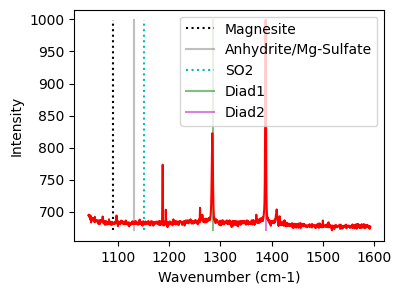

In [5]:
plot1=pf.plot_diad(path=spectra_path, filename=Diad_Files[i], filetype=spectra_filetype)

## Now lets inspect the diads and get their approximate positions
- As with generic peak, you can exclude 2 segments (e.g. around cosmic rays)
- You then specify how many peaks you want to fit on each diad. 1 means just the strong peak, 2 hotbands, and 3 for Diad2 would also fit the C13 peak if present. 
- The identify_diad_peaks then uses scipy findpeaks to identify the positions of the 2 diads, and any other peaks the user asks for. These are saved, and fed into the later functions for peak fitting. 

## Choose a model for fitting all peaks
- Option of Voigt or PseudoVoigt. We recomend PsuedoVoigt

In [6]:
model_name='PseudoVoigtModel'

## Fit Diad 1
- Tweak the parameters in the config files for each group. E.g. how many peaks (fit_peaks), the background positions, the sigma of the diad, and whether or not you want a gaussian background

In [7]:
diad_id_config=pf.diad_id_config(height=50, exclude_range1=[1308, 1309])
diad_id_config

if batch=='Weak':
    diad1_fit_config_init=pf.diad1_fit_config(
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1250),
    upper_bck_diad1=(1300, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=100, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
    diad1_fit_config_init

if batch=='Medium':
    diad1_fit_config_init=pf.diad1_fit_config(
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=2, lower_bck_diad1=(1180, 1240),
    upper_bck_diad1=(1315, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=100, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
    diad1_fit_config_init

if batch=='Strong':
    diad1_fit_config_init=pf.diad1_fit_config(
    fit_gauss=True, gauss_amp= 2*GroupN_df['HB1_abs_prom'].iloc[i],
    model_name=model_name, fit_peaks=2,
    N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1220),
    upper_bck_diad1=(1330, 1350),
    diad_sigma=0.6,
    x_range_residual=10, x_range_baseline=30, 
     y_range_baseline=1000, 
    HB_prom=GroupN_df['HB1_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i])
diad1_fit_config_init

diad1_fit_config(model_name='PseudoVoigtModel', fit_peaks=2, N_poly_bck_diad1=1, lower_bck_diad1=(1180, 1250), upper_bck_diad1=(1300, 1350), fit_gauss=False, gauss_amp=1000, diad_sigma=0.6, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=140.30031794386673, HB_prom=nan, x_range_baseline=30, y_range_baseline=100, dpi=200, x_range_residual=10, return_other_params=False)

### See what these fit parameters look like for diad1

,Diad1_Combofit_Cent,Diad1_Voigt_Cent,Diad1_cent_err,Diad1_Voigt_Area,Diad1_Voigt_Sigma,Diad1_Voigt_Gamma,Diad1_Combofit_Height,Diad1_Residual,Diad1_Prop_Lor,Diad1_fwhm,Diad1_refit,Diad1_Asym50,Diad1_Asym70,Diad1_Yuan2017_sym_factor,Diad1_Remigi2021_BSF,Diad1_PDF_Model
0,1284.095122,1284.095122,0.041181,484.387455,1.34829,0,138.03836,3.142159,0.564629,2.696579,Flagged Warnings:,1.012376,1.014286,0.033374,0.019535,PseudoVoigtModel


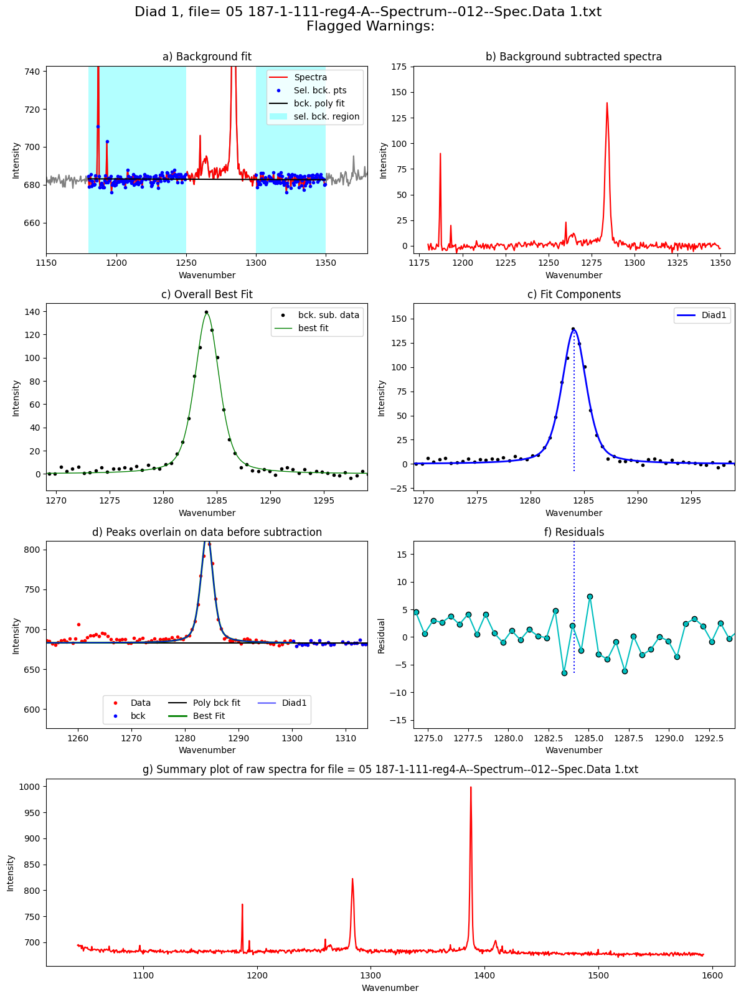

In [8]:
Diad1_fit=pf.fit_diad_1_w_bck(config1=diad1_fit_config_init,
config2=diad_id_config,
path=spectra_path, filename=Diad_Files.iloc[0],
filetype=spectra_filetype, plot_figure=True, close_figure=False,
Diad_pos=GroupN_df['Diad1_pos'].iloc[i],
HB_pos=GroupN_df['HB1_pos'].iloc[i])
Diad1_fit

### Update the sigma
- The sigma parameter varies quite a lot based on the splitting. Best to update your first guess with what you found for the example file above

In [9]:
diad1_fit_config2=diad1_fit_config_init

## Fit diad2

In [10]:
if batch=='Weak':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=2, upper_bck_diad2=(1430, 1480),
    lower_bck_diad2=(1310, 1360), diad_sigma=0.4,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=100,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i])
    diad2_fit_config_init

if batch=='Medium':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=3, fit_gauss=True, gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i],
    lower_bck_diad2=(1310, 1350), diad_sigma=1,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=100,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i],
    C13_prom=GroupN_df['C13_abs_prom'].iloc[i])
    diad2_fit_config_init

if batch=='Strong':
    diad2_fit_config_init=pf.diad2_fit_config(model_name=model_name,
    fit_peaks=3, fit_gauss=True, gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i],
    lower_bck_diad2=(1310, 1340), diad_sigma=1,  N_poly_bck_diad2=2,                                       
    x_range_residual=30, y_range_baseline=1000,  
    x_range_baseline=30,
    HB_prom=GroupN_df['HB2_abs_prom'].iloc[i], 
    diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i],
    C13_prom=GroupN_df['C13_abs_prom'].iloc[i])
    diad2_fit_config_init
diad2_fit_config_init

diad2_fit_config(model_name='PseudoVoigtModel', fit_peaks=2, N_poly_bck_diad2=2, lower_bck_diad2=(1310, 1360), upper_bck_diad2=(1430, 1480), fit_gauss=False, gauss_amp=1000, diad_sigma=0.4, diad_sigma_min_allowance=0.2, diad_sigma_max_allowance=5, diad_prom=318.8711714538888, HB_prom=nan, C13_prom=10, x_range_baseline=30, y_range_baseline=100, plot_figure=True, dpi=200, x_range_residual=30, return_other_params=False)

### See what these fit parameters look like for diad2

,Diad2_Combofit_Cent,Diad2_Voigt_Cent,Diad2_cent_err,Diad2_Voigt_Area,Diad2_Voigt_Sigma,Diad2_Voigt_Gamma,Diad2_Combofit_Height,Diad2_Residual,Diad2_Prop_Lor,Diad2_fwhm,Diad2_refit,Diad2_Asym50,Diad2_Asym70,Diad2_Yuan2017_sym_factor,Diad2_Remigi2021_BSF,Diad2_PDF_Model
0,1388.050869,1388.050869,0.008195,764.865303,0.871575,0,319.398248,3.303867,0.698505,1.74315,Flagged Warnings:,1.059172,1.118841,0.103145,0.005458,PseudoVoigtModel


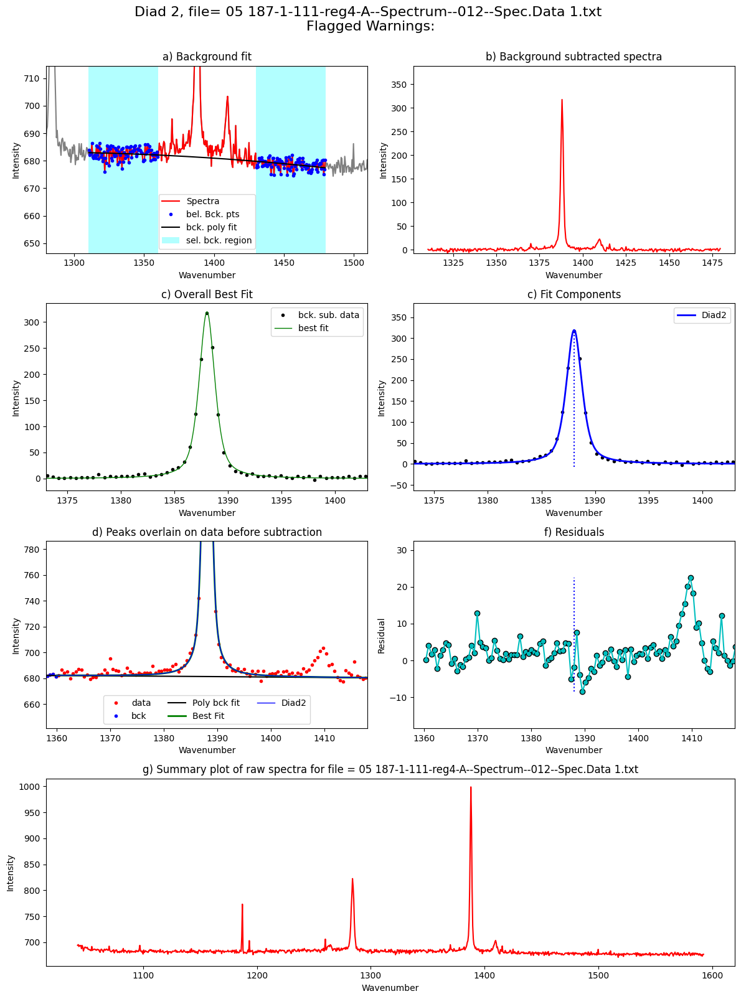

In [11]:
Diad2_fit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_init,
    config2=diad_id_config,
path=spectra_path, filename=Diad_Files[i], filetype=spectra_filetype,
plot_figure=True, close_figure=False, 
Diad_pos=GroupN_df['Diad2_pos'].iloc[i],
HB_pos=GroupN_df['HB2_pos'].iloc[i], 
C13_pos=GroupN_df['C13_pos'].iloc[i])
Diad2_fit.to_clipboard(excel=True)
Diad2_fit

## Loop over all the files in the group
- This will loop over all the 

  0%|          | 0/42 [00:00<?, ?it/s]

Processing file: 05 187-1-111-reg4-A--Spectrum--012--Spec.Data 1.txt


  2%|▏         | 1/42 [00:02<01:22,  2.01s/it]

Processing file: 06 187-1-111-reg4-A--Spectrum--013--Spec.Data 1.txt


  5%|▍         | 2/42 [00:04<01:20,  2.01s/it]

Processing file: 07 187-1-111-reg4-A--Spectrum--014--Spec.Data 1.txt


  7%|▋         | 3/42 [00:05<01:16,  1.96s/it]

Processing file: 08 187-1-111-reg4-B--Spectrum--016--Spec.Data 1.txt


 10%|▉         | 4/42 [00:07<01:14,  1.95s/it]

Processing file: 09 187-1-111-reg4-B--Spectrum--017--Spec.Data 1.txt


 12%|█▏        | 5/42 [00:09<01:12,  1.96s/it]

Processing file: 10 187-1-111-reg4-B--Spectrum--018--Spec.Data 1.txt


 14%|█▍        | 6/42 [00:11<01:08,  1.91s/it]

Processing file: 12 187-1-111-reg4-C--Spectrum--021--Spec.Data 1.txt


 17%|█▋        | 7/42 [00:13<01:08,  1.97s/it]

Processing file: 13 187-1-111-reg4-C--Spectrum--022--Spec.Data 1.txt


 19%|█▉        | 8/42 [00:15<01:08,  2.02s/it]

Processing file: 14 187-1-111-reg4-C--Spectrum--023--Spec.Data 1_CRR_DiadFit.txt


 21%|██▏       | 9/42 [00:17<01:06,  2.02s/it]

Processing file: 16 187-1-111-reg5-A--Spectrum--032--Spec.Data 1.txt


 24%|██▍       | 10/42 [00:20<01:06,  2.08s/it]c:\users\charl\documents\python dev\diadfit\src\DiadFit\diads.py:3104: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig,axes=plt.subplot_mosaic(mosaic=figure_mosaic, figsize=(12, 16))


Processing file: 17 187-1-111-reg5-A--Spectrum--033--Spec.Data 1_CRR_DiadFit.txt


 26%|██▌       | 11/42 [00:22<01:03,  2.04s/it]

Processing file: 18 187-1-111-reg5-A--Spectrum--034--Spec.Data 1_CRR_DiadFit.txt


 29%|██▊       | 12/42 [00:25<01:14,  2.49s/it]

Processing file: 19 187-1-111-reg5-B--Spectrum--036--Spec.Data 1.txt


 31%|███       | 13/42 [00:29<01:27,  3.01s/it]

Processing file: 21 187-1-111-reg5-C--Spectrum--038--Spec.Data 1.txt


 33%|███▎      | 14/42 [00:33<01:33,  3.34s/it]

Processing file: 22 187-1-111-reg5-D--Spectrum--041--Spec.Data 1.txt


 36%|███▌      | 15/42 [00:37<01:32,  3.44s/it]

Processing file: 23 187-1-111-reg6-A--Spectrum--047--Spec.Data 1.txt


 38%|███▊      | 16/42 [00:40<01:29,  3.43s/it]

Processing file: 24 187-1-111-reg6-B--Spectrum--048--Spec.Data 1.txt


 40%|████      | 17/42 [00:44<01:29,  3.57s/it]

Processing file: 25 187-1-111-reg7-A--Spectrum--055--Spec.Data 1.txt


 43%|████▎     | 18/42 [00:48<01:28,  3.69s/it]

Processing file: 26 187-1-111-reg7-B--Spectrum--057--Spec.Data 1_CRR_DiadFit.txt


 45%|████▌     | 19/42 [00:52<01:25,  3.74s/it]

Processing file: 28 187-1-111-reg8-A--Spectrum--061--Spec.Data 1.txt


 48%|████▊     | 20/42 [00:56<01:22,  3.74s/it]

Processing file: 29 187-1-111-reg8-B--Spectrum--063--Spec.Data 1.txt


 50%|█████     | 21/42 [01:00<01:21,  3.86s/it]

Processing file: 30 187-1-111-reg8-C--Spectrum--065--Spec.Data 1.txt


 52%|█████▏    | 22/42 [01:05<01:20,  4.04s/it]

Processing file: 32 187-1-112-reg1-A--Spectrum--079--Spec.Data 1.txt


 55%|█████▍    | 23/42 [01:08<01:15,  3.96s/it]

Processing file: 33 187-1-112-reg2-A--Spectrum--082--Spec.Data 1.txt


 57%|█████▋    | 24/42 [01:13<01:12,  4.05s/it]

Processing file: 34 187-1-112-reg2-B--Spectrum--085--Spec.Data 1_CRR_DiadFit.txt


 60%|█████▉    | 25/42 [01:16<01:07,  3.95s/it]

Processing file: 35 187-1-112-reg2-C--Spectrum--088--Spec.Data 1_CRR_DiadFit.txt


 62%|██████▏   | 26/42 [01:20<01:02,  3.91s/it]

Processing file: 37 187-1-112-reg3-A--Spectrum--094--Spec.Data 1.txt


 64%|██████▍   | 27/42 [01:24<00:58,  3.89s/it]

Processing file: 38 187-1-112-reg3-B--Spectrum--096--Spec.Data 1.txt


 67%|██████▋   | 28/42 [01:28<00:55,  3.96s/it]

Processing file: 39 187-1-112-reg3-C--Spectrum--097--Spec.Data 1.txt


 69%|██████▉   | 29/42 [01:32<00:50,  3.86s/it]

Processing file: 41 187-1-112-reg4-A--Spectrum--105--Spec.Data 1.txt


 71%|███████▏  | 30/42 [01:35<00:45,  3.76s/it]

Processing file: 42 187-1-112-reg4-B--Spectrum--107--Spec.Data 1_CRR_DiadFit.txt


 74%|███████▍  | 31/42 [01:39<00:42,  3.89s/it]

Processing file: 43 187-1-112-reg4-C--Spectrum--109--Spec.Data 1.txt


 76%|███████▌  | 32/42 [01:43<00:38,  3.90s/it]

Processing file: 44 187-1-112-reg5-A--Spectrum--114--Spec.Data 1_CRR_DiadFit.txt


 79%|███████▊  | 33/42 [01:47<00:34,  3.86s/it]

Processing file: 45 187-1-112-reg5-B--Spectrum--116--Spec.Data 1.txt


 81%|████████  | 34/42 [01:51<00:30,  3.83s/it]

Processing file: 46 187-1-112-reg5-C--Spectrum--118--Spec.Data 1.txt


 83%|████████▎ | 35/42 [01:55<00:27,  3.93s/it]

Processing file: 48 187-1-112-reg6-A--Spectrum--123--Spec.Data 1.txt


 86%|████████▌ | 36/42 [01:59<00:22,  3.82s/it]

Processing file: 49 187-1-112-reg6-B--Spectrum--125--Spec.Data 1_CRR_DiadFit.txt


 88%|████████▊ | 37/42 [02:02<00:18,  3.76s/it]

Processing file: 50 187-1-112-reg6-C--Spectrum--127--Spec.Data 1.txt


 90%|█████████ | 38/42 [02:06<00:14,  3.72s/it]

Processing file: 51 187-1-112-reg7-A--Spectrum--131--Spec.Data 1.txt


 93%|█████████▎| 39/42 [02:10<00:11,  3.82s/it]

Processing file: 52 187-1-112-reg7-B--Spectrum--133--Spec.Data 1.txt


 95%|█████████▌| 40/42 [02:13<00:07,  3.70s/it]

Processing file: 53 187-1-112-reg7-C--Spectrum--135--Spec.Data 1.txt


 98%|█████████▊| 41/42 [02:16<00:03,  3.52s/it]

Processing file: 58 FO1--Spectrum--141--Spec.Data 1.txt


100%|██████████| 42/42 [02:20<00:00,  3.34s/it]


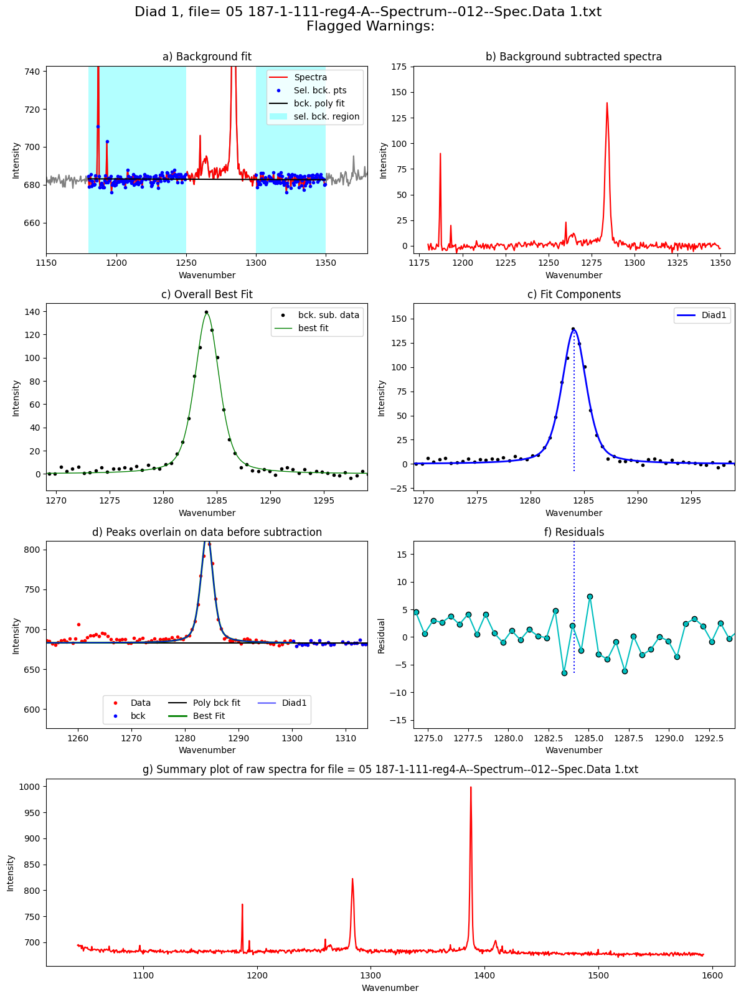

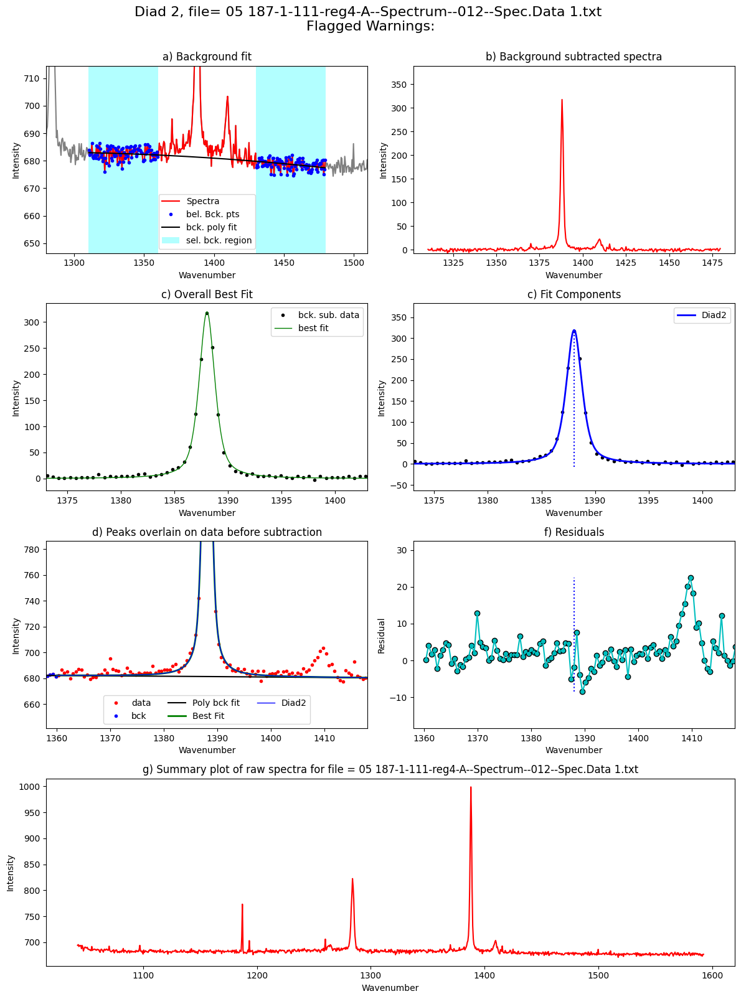

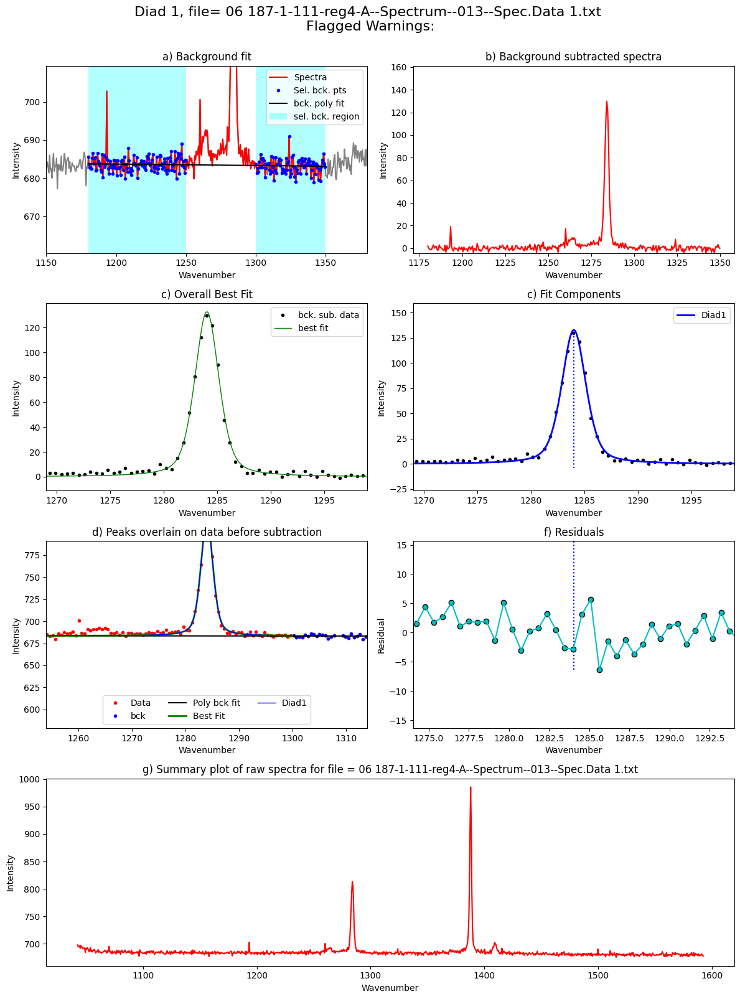

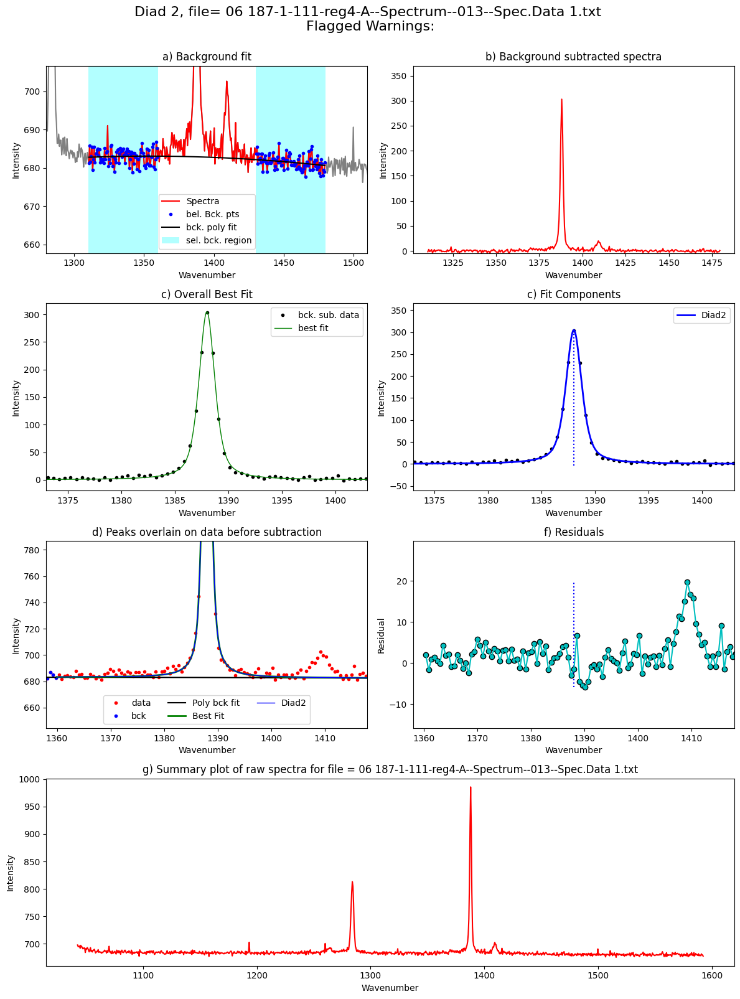

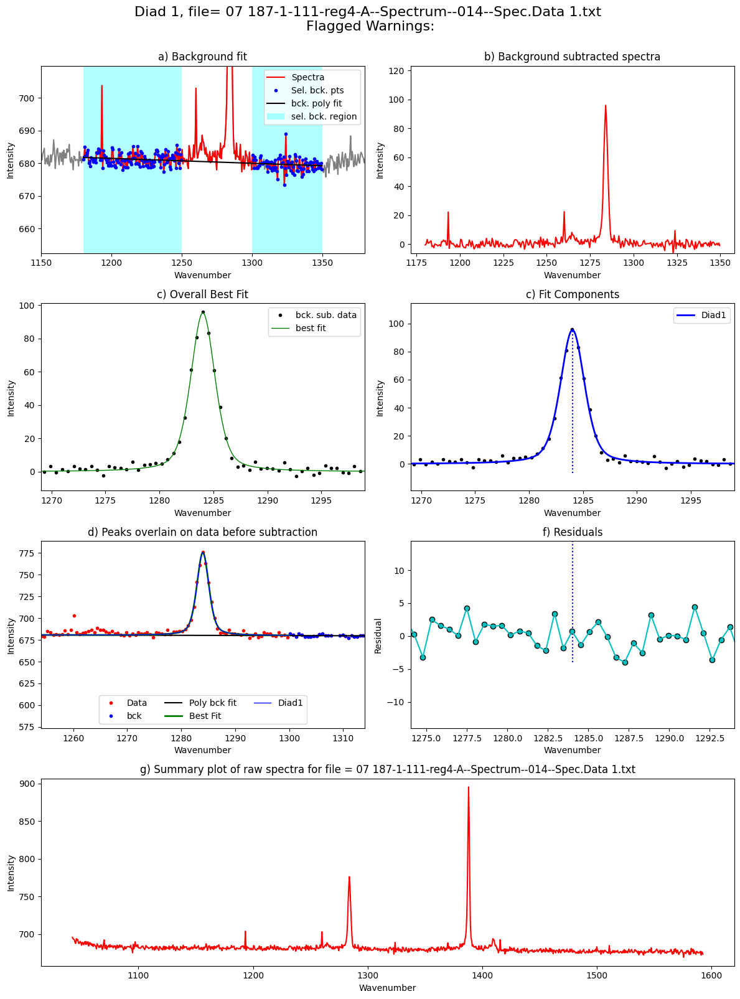

...

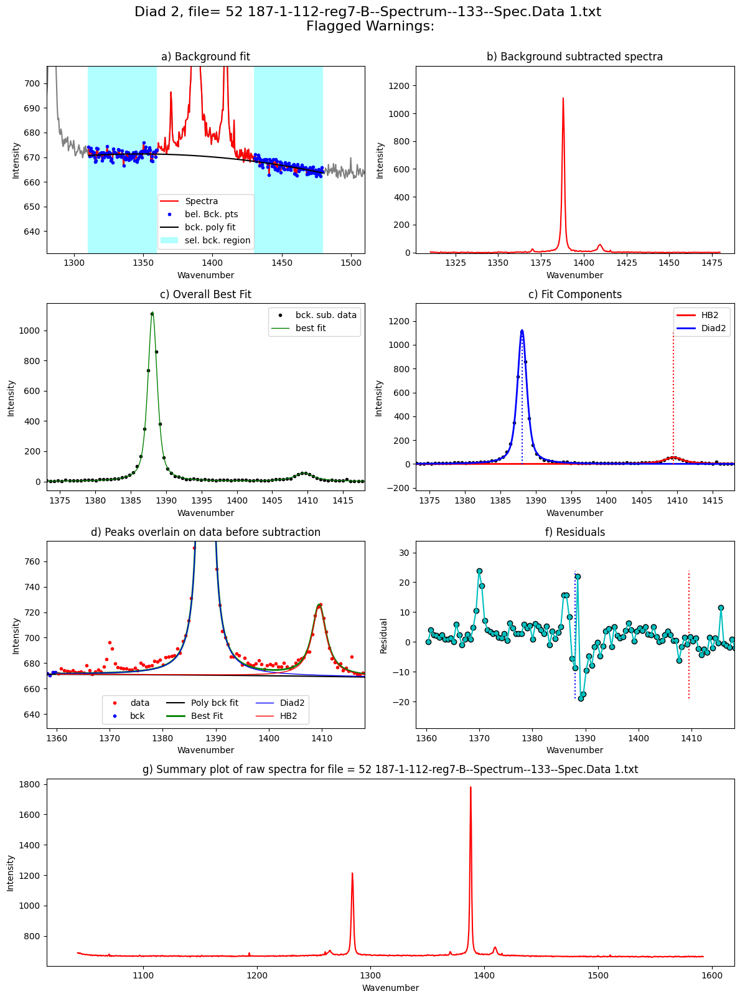

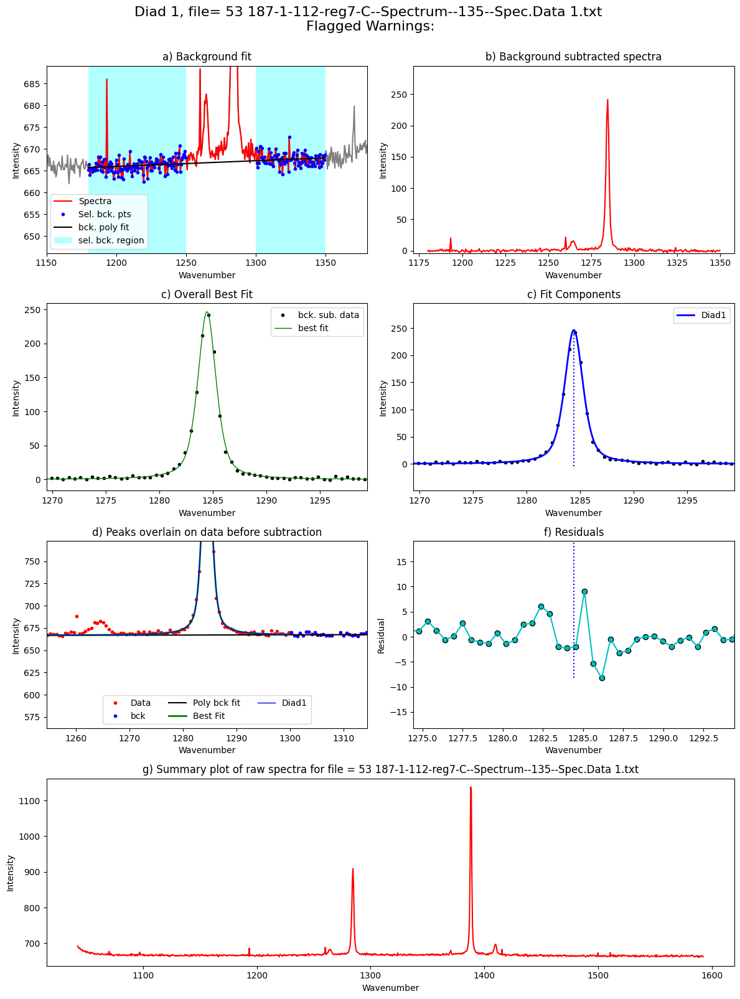

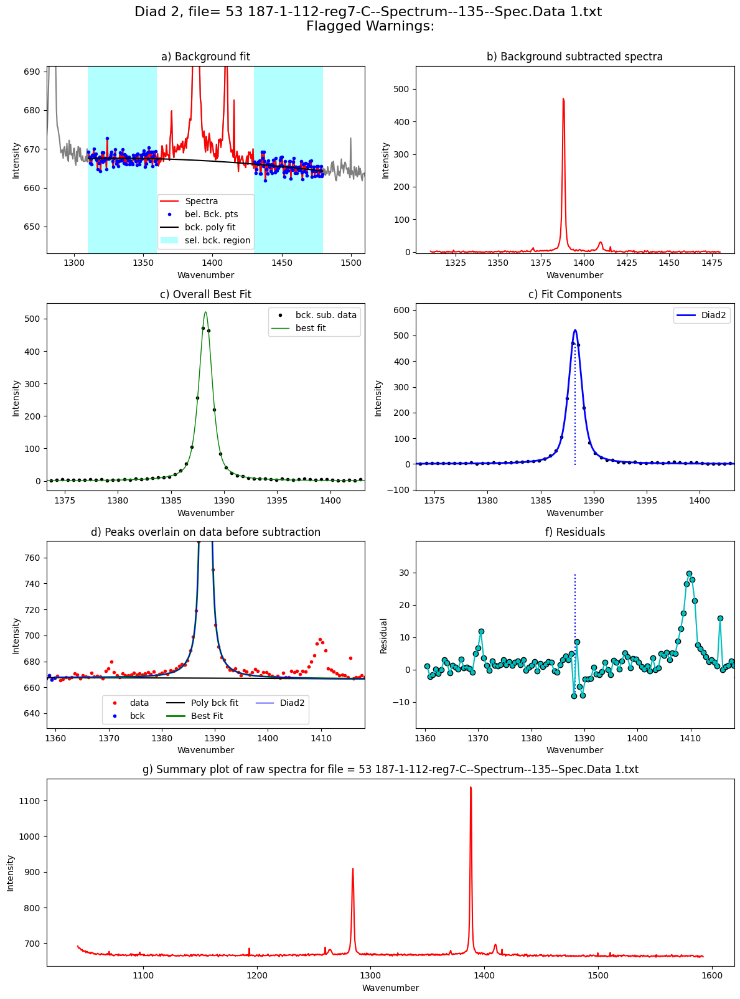

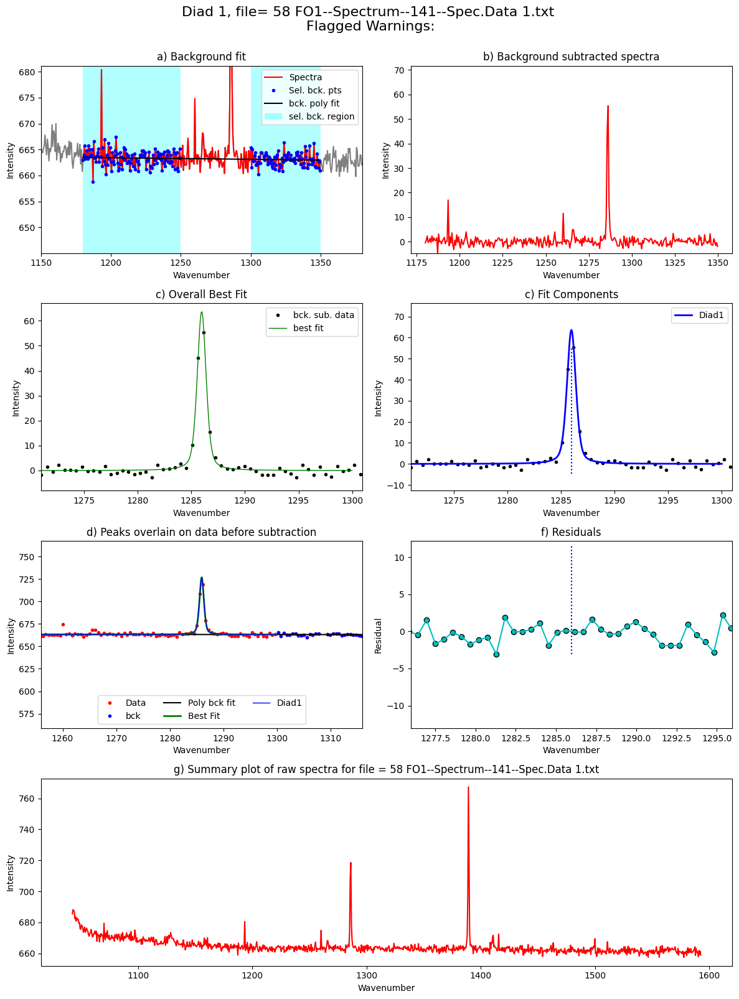

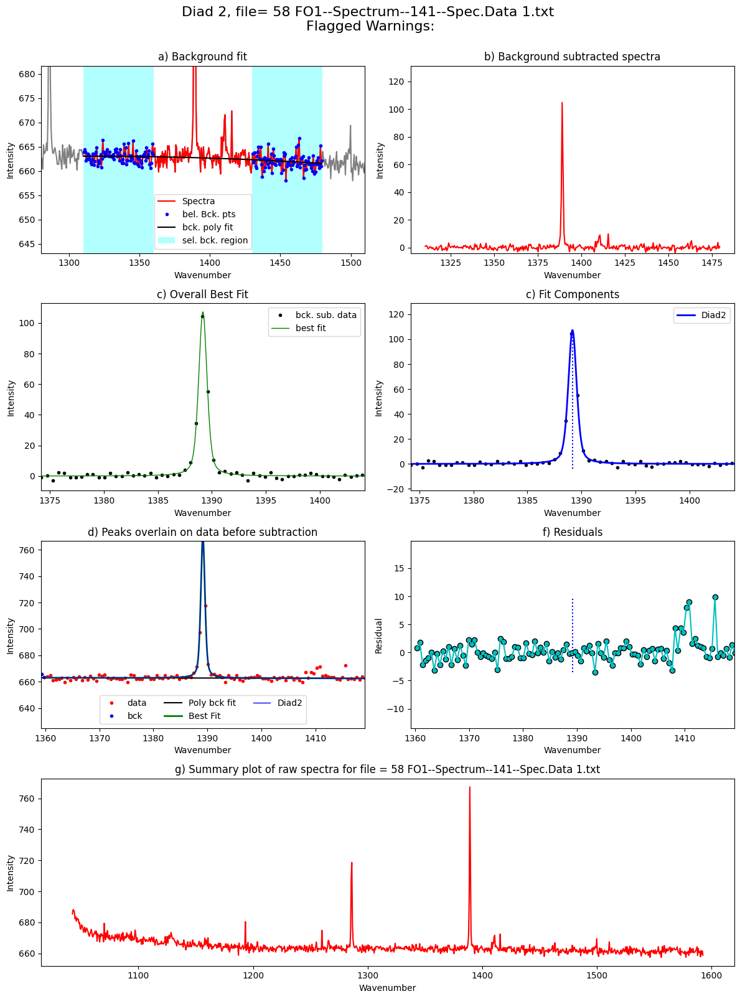

In [12]:
from tqdm import tqdm
plot_figure=True# If False, Means doesnt have to make figures, lot faster. 
close_figure=False # If True, wont show figures in notebook, but will still save them in a folder 
Diad_Files_i=Diad_Files
df_Merge = pd.DataFrame([])
for i in tqdm(range(0, len(Diad_Files))): #
    tqdm.write(f"Processing file: {Diad_Files[i]}")
    
    
    # For diad1, config file like you had in the previous. 
    # Only really used to exclude a range (say your spectra has a known spec)
    diad_id_config=pf.diad_id_config(exclude_range1=[1308, 1309])
    
    # Here, the prominence are taken from the fitting in the last notebook
    diad1_fit_config2.HB_prom=GroupN_df['HB1_abs_prom'].iloc[i]
    diad1_fit_config2.diad_prom=GroupN_df['Diad1_abs_prom'].iloc[i]
    diad1_fit_config2.gauss_amp=2*GroupN_df['HB1_abs_prom'].iloc[i]

    Diad1_fit=pf.fit_diad_1_w_bck(config1=diad1_fit_config2,
    config2=diad_id_config, path=spectra_path, filename=GroupN_df['filename'].iloc[i],
    filetype=spectra_filetype, plot_figure=plot_figure, close_figure=close_figure,
    Diad_pos=GroupN_df['Diad1_pos'].iloc[i],
    HB_pos=GroupN_df['HB1_pos'].iloc[i])

    ## Same for diad2, just also has a C13 peak
    diad2_fit_config_init.HB_prom=GroupN_df['HB2_abs_prom'].iloc[i]
    diad2_fit_config_init.diad_prom=GroupN_df['Diad2_abs_prom'].iloc[i]
    diad2_fit_config_init.gauss_amp= 2*GroupN_df['HB2_abs_prom'].iloc[i]
    diad2_fit_config_init.C13_prom=GroupN_df['C13_abs_prom'].iloc[i]
    
    
    Diad2_fit=pf.fit_diad_2_w_bck(config1=diad2_fit_config_init,
        config2=diad_id_config,
    path=spectra_path, filename=GroupN_df['filename'].iloc[i], 
    filetype=spectra_filetype,
    plot_figure=plot_figure, close_figure=close_figure,
    Diad_pos=GroupN_df['Diad2_pos'].iloc[i],
    HB_pos=GroupN_df['HB2_pos'].iloc[i], 
    C13_pos=GroupN_df['C13_pos'].iloc[i])
    
    # This combines the outputs into a single dataframe
    data=pf.combine_diad_outputs(filename=GroupN_df['filename'].iloc[i], prefix=prefix, 
    Diad1_fit=Diad1_fit, path=spectra_path,                  
    Diad2_fit=Diad2_fit)        
    
 

    df_Merge = pd.concat([df_Merge, data], axis=0).reset_index(drop=True)


In [13]:
# Save parameters to excel
combo=df_Merge

if batch=='Weak':
    combo.to_excel('Weak_Diads.xlsx', index=False)
if batch=='Medium':
    combo.to_excel('Medium_Diads.xlsx', index=False)
if batch=='Strong':
    combo.to_excel('Strong_Diads.xlsx', index=False)

In [14]:
combo

,filename,Splitting,Split_σ,Diad1_Combofit_Cent,Diad1_cent_err,Diad1_Combofit_Height,Diad1_Voigt_Cent,Diad1_Voigt_Area,Diad1_Voigt_Sigma,Diad1_Residual,...,Diad1_Asym50,Diad1_Asym70,Diad1_Yuan2017_sym_factor,Diad1_Remigi2021_BSF,Diad2_Asym50,Diad2_Asym70,Diad2_Yuan2017_sym_factor,Diad2_Remigi2021_BSF,Diad1_PDF_Model,Diad2_PDF_Model
0,187-1-111-reg4-A--Spectrum--012--Spec.Data 1,103.955747,0.041988,1284.095122,0.041181,138.038360,1284.095122,484.387455,1.348290,3.142159,...,1.012376,1.014286,0.033374,0.019535,1.059172,1.118841,0.103145,0.005458,PseudoVoigtModel,PseudoVoigtModel
1,187-1-111-reg4-A--Spectrum--013--Spec.Data 1,103.972925,0.020018,1284.031975,0.018464,132.758709,1284.031975,454.305220,1.334535,2.617592,...,1.142098,1.189796,0.379270,0.020105,1.068762,1.106169,0.121248,0.005787,PseudoVoigtModel,PseudoVoigtModel
2,187-1-111-reg4-A--Spectrum--014--Spec.Data 1,104.024513,0.027741,1284.023547,0.025885,95.275678,1284.023547,324.050694,1.329050,2.175436,...,1.001245,1.068865,0.003310,0.027899,1.003810,1.085795,0.006678,0.008053,PseudoVoigtModel,PseudoVoigtModel
3,187-1-111-reg4-B--Spectrum--016--Spec.Data 1,104.219417,0.010364,1283.578519,0.010012,452.193436,1283.578519,1485.881273,1.254442,5.870318,...,1.133427,1.136316,0.334753,0.005548,1.050980,1.025000,0.088464,0.001741,PseudoVoigtModel,PseudoVoigtModel
4,187-1-111-reg4-B--Spectrum--017--Spec.Data 1,104.210134,0.010121,1283.597691,0.009832,436.507659,1283.597691,1448.303545,1.247749,5.289250,...,1.091034,1.101554,0.227176,0.005717,1.001883,1.016506,0.003316,0.001834,PseudoVoigtModel,PseudoVoigtModel
5,187-1-111-reg4-B--Spectrum--018--Spec.Data 1,104.160754,0.010567,1283.675024,0.010249,407.519017,1283.675024,1373.642835,1.293273,5.270999,...,1.076821,1.079208,0.198702,0.006347,1.028249,1.009321,0.050778,0.002018,PseudoVoigtModel,PseudoVoigtModel
6,187-1-111-reg4-C--Spectrum--021--Spec.Data 1,104.304184,0.003535,1283.408064,0.002986,730.258645,1283.408114,2135.445520,1.071798,2.688773,...,1.017488,1.018038,0.037487,0.002935,1.012500,1.034328,0.019993,0.001022,PseudoVoigtModel,PseudoVoigtModel
7,187-1-111-reg4-C--Spectrum--022--Spec.Data 1,104.302742,0.003486,1283.416542,0.002858,725.813422,1283.416592,2139.217426,1.085733,2.351550,...,1.001548,1.011223,0.003361,0.002992,1.002092,1.025526,0.003303,0.000999,PseudoVoigtModel,PseudoVoigtModel
8,187-1-111-reg4-C--Spectrum--023--Spec.Data 1_C...,104.298908,0.007893,1283.418918,0.007565,611.068623,1283.418918,1806.201280,1.060779,6.028261,...,1.001577,1.004530,0.003346,0.003472,1.066098,1.077744,0.105790,0.001229,PseudoVoigtModel,PseudoVoigtModel
9,187-1-111-reg5-A--Spectrum--032--Spec.Data 1,104.309121,0.007736,1283.423282,0.007433,480.890557,1283.423282,1441.329022,1.092834,4.807239,...,1.060800,1.033113,0.132889,0.004545,1.079060,1.100304,0.127978,0.001561,PseudoVoigtModel,PseudoVoigtModel


### This plays a sound when the notebook is done if you have a tendency to procrastinate

In [15]:
# !pip install winotify

from winotify import Notification, audio

toast= Notification(app_id="VSCode",title="Notebook completed",
                    msg="Step3b_Secondary_Peaks is done!",
                    duration="short")
toast.set_audio(audio.Mail,loop=False)
toast.show()